In [1]:
from IPython.display import display, HTML

display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
!python -V

Python 3.11.2


In [3]:
import binpan
from binpan import handlers

Numba imported


In [4]:
binpan.__version__

'0.7.10'

# Get some data

In [5]:
btcusdt = binpan.Symbol(symbol='btcusdt',
                        tick_interval='1h',
                        limit=1000,
                        time_zone='Europe/Madrid')

2023-11-14	 19:16:18     INFO get_candles_by_time_stamps -> symbol=BTCUSDT tick_interval=1h start=2023-10-04 04:16:18 end=2023-11-14 18:59:58
2023-11-14	 19:16:18  WARNING API response missing 1 klines (maybe not closed yet) for BTCUSDT 2023-10-04 04:16:18 to 2023-11-14 18:59:58 expected 1000 got 999


In [6]:
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp
BTCUSDT 1h Europe/Madrid,,,,,,,,,,,,,,
2023-10-04 05:00:00+02:00,2023-10-04 05:00:00+02:00,27412.14,27465.14,27404.96,27430.43,495.69234,2023-10-04 05:59:59.999000+02:00,1.359634e+07,27662,250.96368,6.883422e+06,0,1696388400000,1696391999999
2023-10-04 06:00:00+02:00,2023-10-04 06:00:00+02:00,27430.43,27430.44,27380.16,27388.69,415.55456,2023-10-04 06:59:59.999000+02:00,1.138777e+07,26166,160.02013,4.384979e+06,0,1696392000000,1696395599999
2023-10-04 07:00:00+02:00,2023-10-04 07:00:00+02:00,27388.68,27407.42,27357.10,27407.18,551.99969,2023-10-04 07:59:59.999000+02:00,1.511687e+07,27499,246.76608,6.757655e+06,0,1696395600000,1696399199999
2023-10-04 08:00:00+02:00,2023-10-04 08:00:00+02:00,27407.18,27419.99,27350.75,27419.99,592.24790,2023-10-04 08:59:59.999000+02:00,1.622025e+07,31753,307.98294,8.435302e+06,0,1696399200000,1696402799999
2023-10-04 09:00:00+02:00,2023-10-04 09:00:00+02:00,27419.99,27454.98,27405.50,27453.78,697.67116,2023-10-04 09:59:59.999000+02:00,1.913777e+07,33750,333.95262,9.160863e+06,0,1696402800000,1696406399999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-14 14:00:00+01:00,2023-11-14 14:00:00+01:00,36348.48,36671.22,36344.85,36503.26,2796.85236,2023-11-14 14:59:59.999000+01:00,1.021498e+08,88076,1430.86542,5.225486e+07,0,1699966800000,1699970399999
2023-11-14 15:00:00+01:00,2023-11-14 15:00:00+01:00,36503.26,36693.01,36462.24,36594.81,1744.40485,2023-11-14 15:59:59.999000+01:00,6.383131e+07,58469,911.47297,3.335072e+07,0,1699970400000,1699973999999
2023-11-14 16:00:00+01:00,2023-11-14 16:00:00+01:00,36594.80,36619.89,35889.00,36147.09,4676.55905,2023-11-14 16:59:59.999000+01:00,1.692032e+08,126648,2061.29968,7.457479e+07,0,1699974000000,1699977599999


# Adding some indicators

Background color is configurable

2023-11-14	 19:16:19     INFO New column: SMA_21


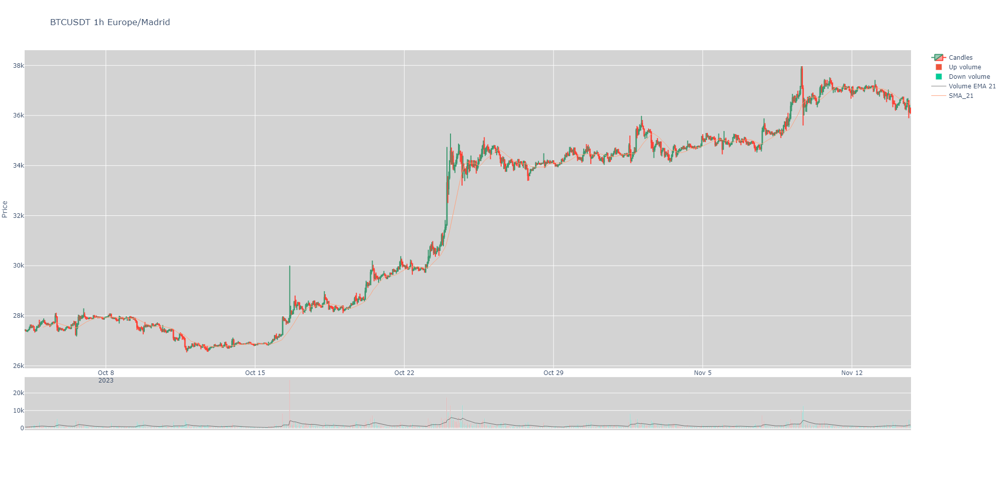

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [7]:
btcusdt.sma(21)

# background color is configurable

btcusdt.plot(background_color='lightgrey')

2023-11-14	 19:16:20     INFO New column: EMA_21


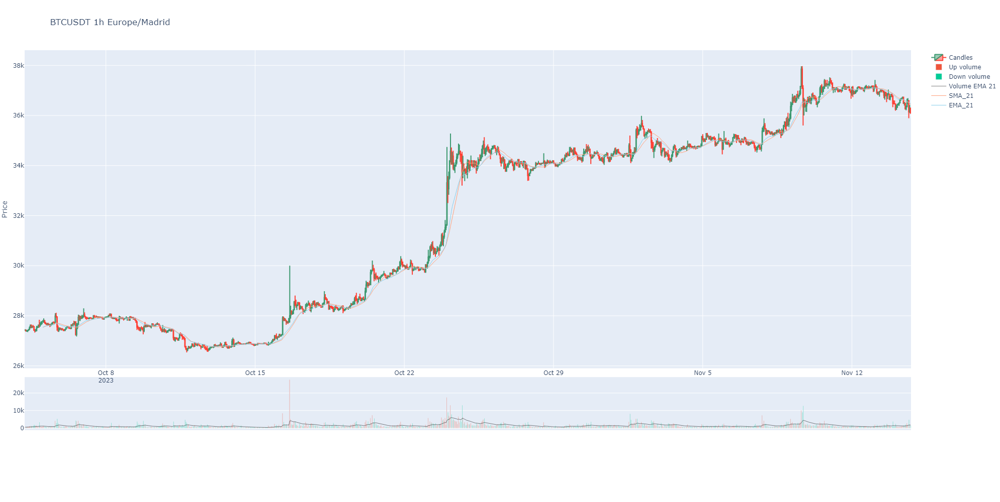

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [8]:
# add ema
btcusdt.ema(21)
btcusdt.plot()

2023-11-14	 19:16:21     INFO New column: zeros
2023-11-14	 19:16:21     INFO New column: MACD_12_26_9
2023-11-14	 19:16:21     INFO New column: MACDh_12_26_9
2023-11-14	 19:16:21     INFO New column: MACDs_12_26_9


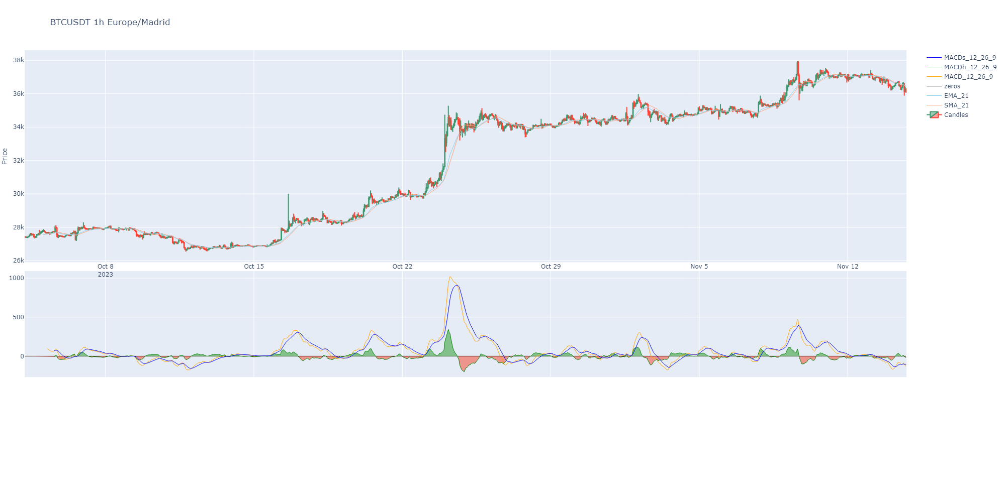

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [9]:
# now with macd
btcusdt.macd()
btcusdt.plot(candles_ta_height_ratio=0.5, volume=False)

2023-11-14	 19:16:22     INFO New column: STOCHRSIk_14_14_3_3
2023-11-14	 19:16:22     INFO New column: STOCHRSId_14_14_3_3


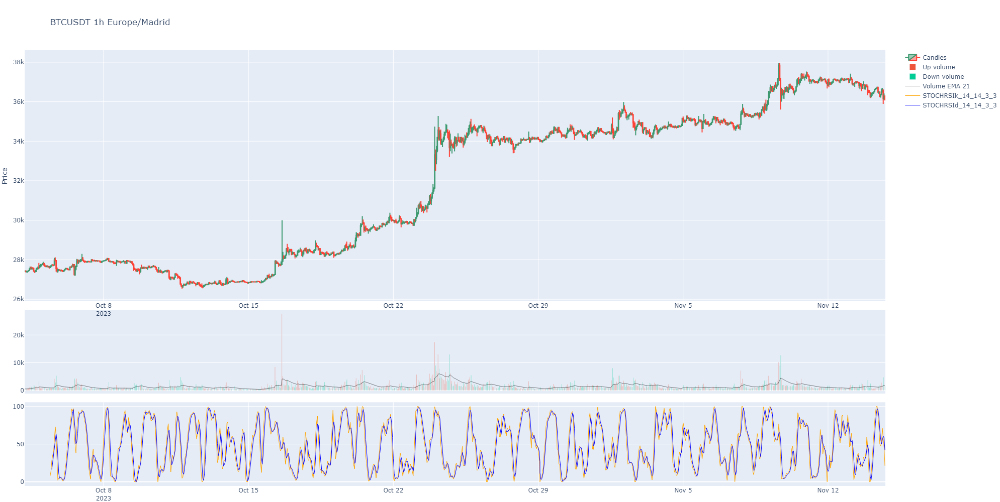

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [10]:
# it is time for stochastic rsi
btcusdt.drop(inplace=True)
btcusdt.stoch_rsi(14,3,3)
btcusdt.plot(candles_ta_height_ratio=0.6)

### Showing the colors applied 

In [11]:
btcusdt.set_plot_color()

{'STOCHRSIk_14_14_3_3': 'orange', 'STOCHRSId_14_14_3_3': 'blue'}

# Example of a generic pandas_ta indicator use:
This indicators are not added to the instance dataframe.

In [12]:
high = btcusdt.df['High']
low = btcusdt.df['Low']
close = btcusdt.df['Close']

rsi = btcusdt.pandas_ta_indicator(name = 'rsi',
                            high=high,
                            low=low, 
                            close=close,
                            length=16,
                            rsi_length=16,
                            k=3,
                            d=3)
rsi

This indicator should be plotted manually with the plotting module. Check docs for candles_ta functions and pass it as an indicator serie. Example: candles_ta(data=btcusdt.df, indicators_series=[rsi])


BTCUSDT 1h Europe/Madrid
2023-10-04 05:00:00+02:00          NaN
2023-10-04 06:00:00+02:00          NaN
2023-10-04 07:00:00+02:00          NaN
2023-10-04 08:00:00+02:00          NaN
2023-10-04 09:00:00+02:00          NaN
                               ...    
2023-11-14 14:00:00+01:00    45.467263
2023-11-14 15:00:00+01:00    48.790182
2023-11-14 16:00:00+01:00    37.022209
2023-11-14 17:00:00+01:00    41.142042
2023-11-14 18:00:00+01:00    37.338796
Name: RSI_16, Length: 999, dtype: float64

# No automated plot, because generic pandas_ta calls are not added to instances.

But can be plotted manually, example.

2023-11-14	 19:16:23     INFO Indicators random colors:  indicators_colors=['seagreen']
2023-11-14	 19:16:23     INFO Inferred positions, sent all to bottom subplot: rows_pos=[2]


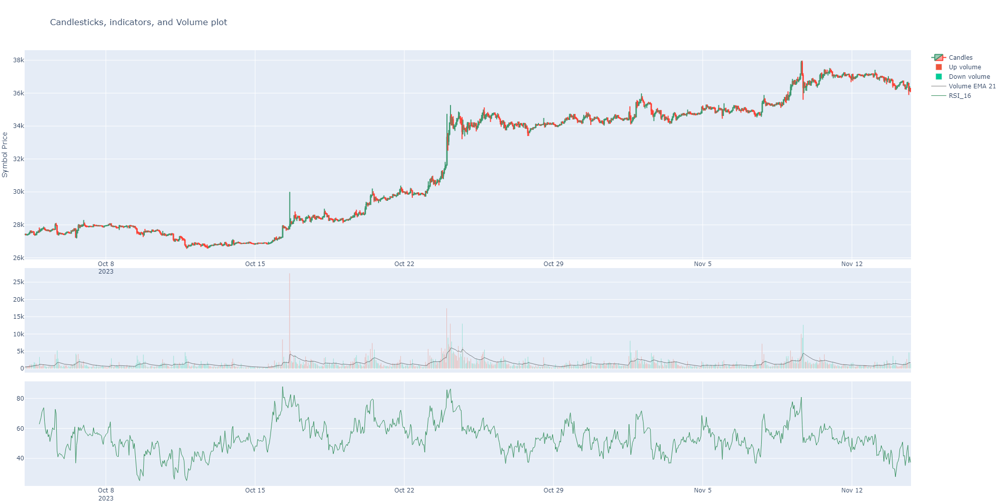

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [13]:
handlers.plotting.candles_ta(data=btcusdt.df, indicators_series=rsi)

In [14]:
# manual indicators are not added automatically to btcusdt.df
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp,STOCHRSIk_14_14_3_3,STOCHRSId_14_14_3_3
BTCUSDT 1h Europe/Madrid,,,,,,,,,,,,,,,,
2023-10-04 05:00:00+02:00,2023-10-04 05:00:00+02:00,27412.14,27465.14,27404.96,27430.43,495.69234,2023-10-04 05:59:59.999000+02:00,1.359634e+07,27662,250.96368,6.883422e+06,0,1696388400000,1696391999999,NaN,NaN
2023-10-04 06:00:00+02:00,2023-10-04 06:00:00+02:00,27430.43,27430.44,27380.16,27388.69,415.55456,2023-10-04 06:59:59.999000+02:00,1.138777e+07,26166,160.02013,4.384979e+06,0,1696392000000,1696395599999,NaN,NaN
2023-10-04 07:00:00+02:00,2023-10-04 07:00:00+02:00,27388.68,27407.42,27357.10,27407.18,551.99969,2023-10-04 07:59:59.999000+02:00,1.511687e+07,27499,246.76608,6.757655e+06,0,1696395600000,1696399199999,NaN,NaN
2023-10-04 08:00:00+02:00,2023-10-04 08:00:00+02:00,27407.18,27419.99,27350.75,27419.99,592.24790,2023-10-04 08:59:59.999000+02:00,1.622025e+07,31753,307.98294,8.435302e+06,0,1696399200000,1696402799999,NaN,NaN
2023-10-04 09:00:00+02:00,2023-10-04 09:00:00+02:00,27419.99,27454.98,27405.50,27453.78,697.67116,2023-10-04 09:59:59.999000+02:00,1.913777e+07,33750,333.95262,9.160863e+06,0,1696402800000,1696406399999,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-14 14:00:00+01:00,2023-11-14 14:00:00+01:00,36348.48,36671.22,36344.85,36503.26,2796.85236,2023-11-14 14:59:59.999000+01:00,1.021498e+08,88076,1430.86542,5.225486e+07,0,1699966800000,1699970399999,52.293391,49.988949
2023-11-14 15:00:00+01:00,2023-11-14 15:00:00+01:00,36503.26,36693.01,36462.24,36594.81,1744.40485,2023-11-14 15:59:59.999000+01:00,6.383131e+07,58469,911.47297,3.335072e+07,0,1699970400000,1699973999999,70.941236,56.822013
2023-11-14 16:00:00+01:00,2023-11-14 16:00:00+01:00,36594.80,36619.89,35889.00,36147.09,4676.55905,2023-11-14 16:59:59.999000+01:00,1.692032e+08,126648,2061.29968,7.457479e+07,0,1699974000000,1699977599999,58.549523,60.594717


# Cleaning data
Before plotting more indicators, let's drop some indicators.

In [15]:
btcusdt.row_control

{'STOCHRSIk_14_14_3_3': 2, 'STOCHRSId_14_14_3_3': 2}

In [16]:
btcusdt.df.columns

Index(['Open time', 'Open', 'High', 'Low', 'Close', 'Volume', 'Close time', 'Quote volume', 'Trades', 'Taker buy base volume', 'Taker buy quote volume', 'Ignore', 'Open timestamp', 'Close timestamp', 'STOCHRSIk_14_14_3_3', 'STOCHRSId_14_14_3_3'], dtype='object')

In [17]:
btcusdt.drop(columns_to_drop=['STOCHRSIk_14_14_3_3', 'STOCHRSId_14_14_3_3'], inplace=True)
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp
BTCUSDT 1h Europe/Madrid,,,,,,,,,,,,,,
2023-10-04 05:00:00+02:00,2023-10-04 05:00:00+02:00,27412.14,27465.14,27404.96,27430.43,495.69234,2023-10-04 05:59:59.999000+02:00,1.359634e+07,27662,250.96368,6.883422e+06,0,1696388400000,1696391999999
2023-10-04 06:00:00+02:00,2023-10-04 06:00:00+02:00,27430.43,27430.44,27380.16,27388.69,415.55456,2023-10-04 06:59:59.999000+02:00,1.138777e+07,26166,160.02013,4.384979e+06,0,1696392000000,1696395599999
2023-10-04 07:00:00+02:00,2023-10-04 07:00:00+02:00,27388.68,27407.42,27357.10,27407.18,551.99969,2023-10-04 07:59:59.999000+02:00,1.511687e+07,27499,246.76608,6.757655e+06,0,1696395600000,1696399199999
2023-10-04 08:00:00+02:00,2023-10-04 08:00:00+02:00,27407.18,27419.99,27350.75,27419.99,592.24790,2023-10-04 08:59:59.999000+02:00,1.622025e+07,31753,307.98294,8.435302e+06,0,1696399200000,1696402799999
2023-10-04 09:00:00+02:00,2023-10-04 09:00:00+02:00,27419.99,27454.98,27405.50,27453.78,697.67116,2023-10-04 09:59:59.999000+02:00,1.913777e+07,33750,333.95262,9.160863e+06,0,1696402800000,1696406399999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-14 14:00:00+01:00,2023-11-14 14:00:00+01:00,36348.48,36671.22,36344.85,36503.26,2796.85236,2023-11-14 14:59:59.999000+01:00,1.021498e+08,88076,1430.86542,5.225486e+07,0,1699966800000,1699970399999
2023-11-14 15:00:00+01:00,2023-11-14 15:00:00+01:00,36503.26,36693.01,36462.24,36594.81,1744.40485,2023-11-14 15:59:59.999000+01:00,6.383131e+07,58469,911.47297,3.335072e+07,0,1699970400000,1699973999999
2023-11-14 16:00:00+01:00,2023-11-14 16:00:00+01:00,36594.80,36619.89,35889.00,36147.09,4676.55905,2023-11-14 16:59:59.999000+01:00,1.692032e+08,126648,2061.29968,7.457479e+07,0,1699974000000,1699977599999


# Not dropped indicators are kept on plot control

In [18]:
# maybe not this time, cause no indicator
btcusdt.row_control

{}

# Continuing with more indicators

2023-11-14	 19:16:23     INFO New column: SUPERT_10_3.0
2023-11-14	 19:16:23     INFO New column: SUPERTd_10_3.0
2023-11-14	 19:16:23     INFO New column: SUPERTl_10_3.0
2023-11-14	 19:16:23     INFO New column: SUPERTs_10_3.0


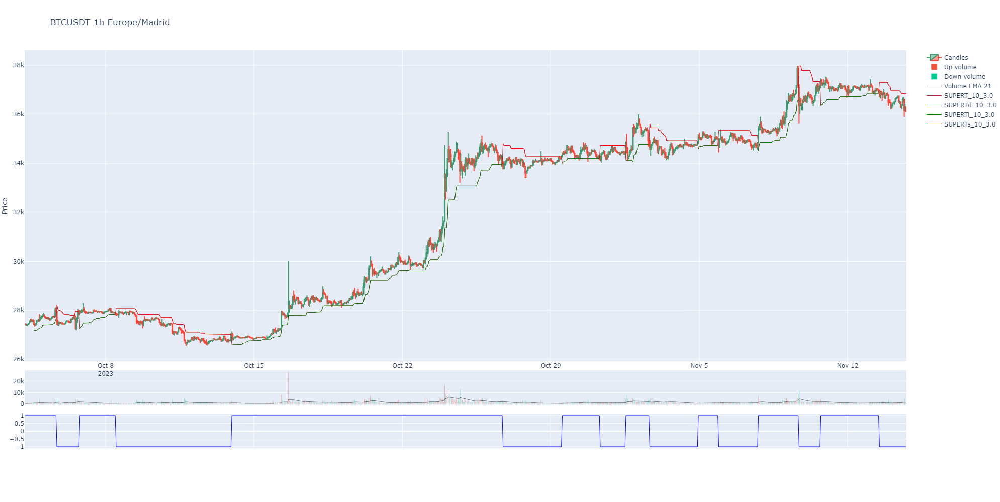

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [19]:
btcusdt.supertrend(length=10, multiplier=3)
btcusdt.plot()

In [20]:
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp,SUPERT_10_3.0,SUPERTd_10_3.0,SUPERTl_10_3.0,SUPERTs_10_3.0
BTCUSDT 1h Europe/Madrid,,,,,,,,,,,,,,,,,,
2023-10-04 05:00:00+02:00,2023-10-04 05:00:00+02:00,27412.14,27465.14,27404.96,27430.43,495.69234,2023-10-04 05:59:59.999000+02:00,1.359634e+07,27662,250.96368,6.883422e+06,0,1696388400000,1696391999999,NaN,1,NaN,NaN
2023-10-04 06:00:00+02:00,2023-10-04 06:00:00+02:00,27430.43,27430.44,27380.16,27388.69,415.55456,2023-10-04 06:59:59.999000+02:00,1.138777e+07,26166,160.02013,4.384979e+06,0,1696392000000,1696395599999,NaN,1,NaN,NaN
2023-10-04 07:00:00+02:00,2023-10-04 07:00:00+02:00,27388.68,27407.42,27357.10,27407.18,551.99969,2023-10-04 07:59:59.999000+02:00,1.511687e+07,27499,246.76608,6.757655e+06,0,1696395600000,1696399199999,NaN,1,NaN,NaN
2023-10-04 08:00:00+02:00,2023-10-04 08:00:00+02:00,27407.18,27419.99,27350.75,27419.99,592.24790,2023-10-04 08:59:59.999000+02:00,1.622025e+07,31753,307.98294,8.435302e+06,0,1696399200000,1696402799999,NaN,1,NaN,NaN
2023-10-04 09:00:00+02:00,2023-10-04 09:00:00+02:00,27419.99,27454.98,27405.50,27453.78,697.67116,2023-10-04 09:59:59.999000+02:00,1.913777e+07,33750,333.95262,9.160863e+06,0,1696402800000,1696406399999,NaN,1,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-14 14:00:00+01:00,2023-11-14 14:00:00+01:00,36348.48,36671.22,36344.85,36503.26,2796.85236,2023-11-14 14:59:59.999000+01:00,1.021498e+08,88076,1430.86542,5.225486e+07,0,1699966800000,1699970399999,36832.000926,-1,NaN,36832.000926
2023-11-14 15:00:00+01:00,2023-11-14 15:00:00+01:00,36503.26,36693.01,36462.24,36594.81,1744.40485,2023-11-14 15:59:59.999000+01:00,6.383131e+07,58469,911.47297,3.335072e+07,0,1699970400000,1699973999999,36832.000926,-1,NaN,36832.000926
2023-11-14 16:00:00+01:00,2023-11-14 16:00:00+01:00,36594.80,36619.89,35889.00,36147.09,4676.55905,2023-11-14 16:59:59.999000+01:00,1.692032e+08,126648,2061.29968,7.457479e+07,0,1699974000000,1699977599999,36832.000926,-1,NaN,36832.000926


2023-11-14	 19:16:24     INFO New column: OBV


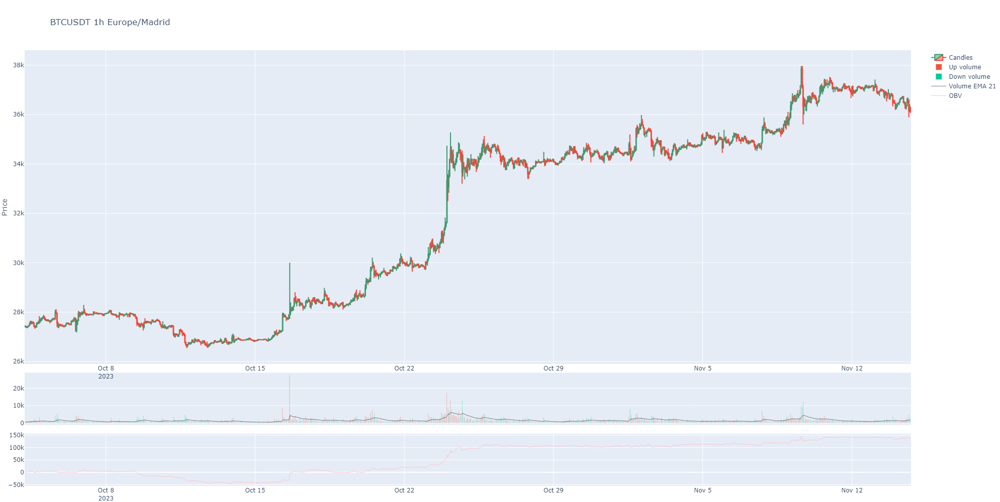

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [21]:
btcusdt.drop(inplace=True)
btcusdt.on_balance_volume()
btcusdt.plot()

In [22]:
btcusdt.row_counter

2

In [23]:
btcusdt.row_control

{'OBV': 2}

2023-11-14	 19:16:25     INFO New column: RSI_14


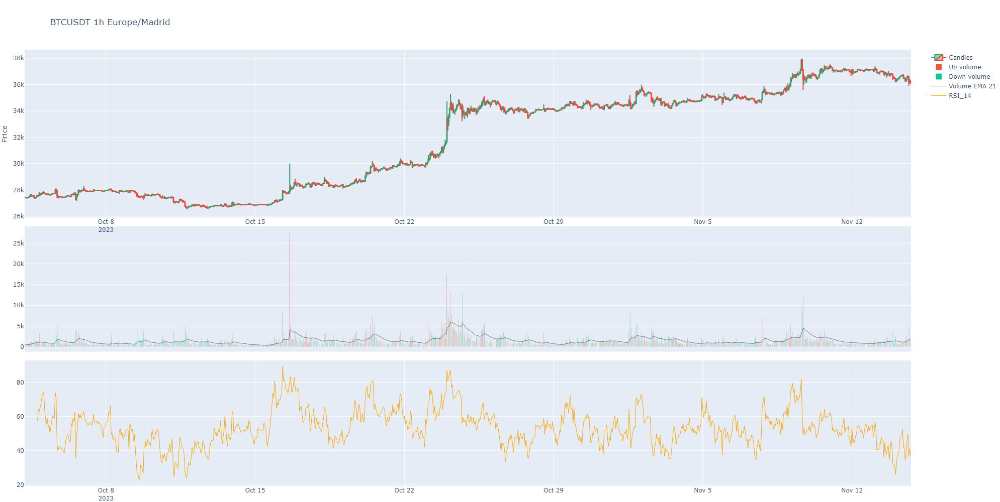

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [24]:
btcusdt.drop(inplace=True)
btcusdt.rsi(length=14)
btcusdt.plot(candles_ta_height_ratio=0.4)

### Repeating request for an indicator don't adds it to the plot control

2023-11-14	 19:16:25     INFO Existing column: RSI_14 -> No data added to instance.


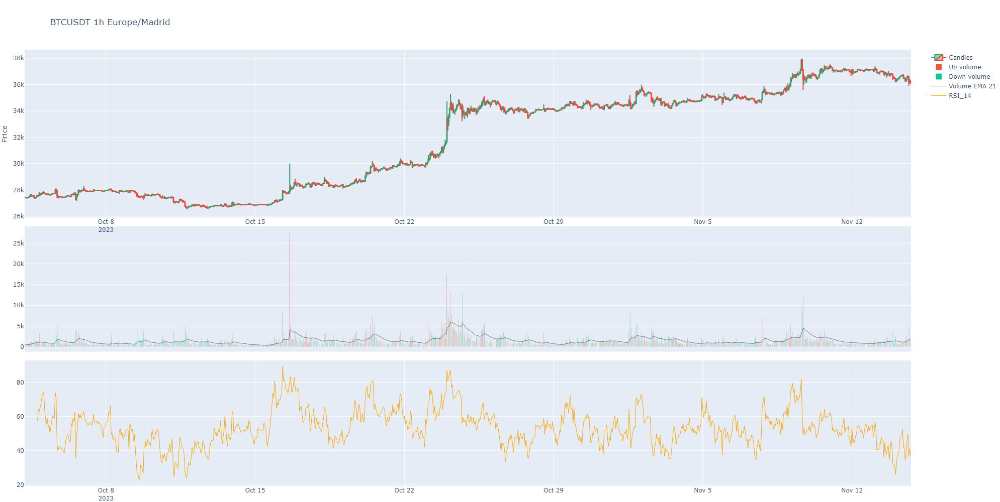

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [25]:
btcusdt.rsi(length=14)
btcusdt.plot(candles_ta_height_ratio=0.4)

In [26]:
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp,RSI_14
BTCUSDT 1h Europe/Madrid,,,,,,,,,,,,,,,
2023-10-04 05:00:00+02:00,2023-10-04 05:00:00+02:00,27412.14,27465.14,27404.96,27430.43,495.69234,2023-10-04 05:59:59.999000+02:00,1.359634e+07,27662,250.96368,6.883422e+06,0,1696388400000,1696391999999,NaN
2023-10-04 06:00:00+02:00,2023-10-04 06:00:00+02:00,27430.43,27430.44,27380.16,27388.69,415.55456,2023-10-04 06:59:59.999000+02:00,1.138777e+07,26166,160.02013,4.384979e+06,0,1696392000000,1696395599999,NaN
2023-10-04 07:00:00+02:00,2023-10-04 07:00:00+02:00,27388.68,27407.42,27357.10,27407.18,551.99969,2023-10-04 07:59:59.999000+02:00,1.511687e+07,27499,246.76608,6.757655e+06,0,1696395600000,1696399199999,NaN
2023-10-04 08:00:00+02:00,2023-10-04 08:00:00+02:00,27407.18,27419.99,27350.75,27419.99,592.24790,2023-10-04 08:59:59.999000+02:00,1.622025e+07,31753,307.98294,8.435302e+06,0,1696399200000,1696402799999,NaN
2023-10-04 09:00:00+02:00,2023-10-04 09:00:00+02:00,27419.99,27454.98,27405.50,27453.78,697.67116,2023-10-04 09:59:59.999000+02:00,1.913777e+07,33750,333.95262,9.160863e+06,0,1696402800000,1696406399999,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-14 14:00:00+01:00,2023-11-14 14:00:00+01:00,36348.48,36671.22,36344.85,36503.26,2796.85236,2023-11-14 14:59:59.999000+01:00,1.021498e+08,88076,1430.86542,5.225486e+07,0,1699966800000,1699970399999,45.929835
2023-11-14 15:00:00+01:00,2023-11-14 15:00:00+01:00,36503.26,36693.01,36462.24,36594.81,1744.40485,2023-11-14 15:59:59.999000+01:00,6.383131e+07,58469,911.47297,3.335072e+07,0,1699970400000,1699973999999,49.608743
2023-11-14 16:00:00+01:00,2023-11-14 16:00:00+01:00,36594.80,36619.89,35889.00,36147.09,4676.55905,2023-11-14 16:59:59.999000+01:00,1.692032e+08,126648,2061.29968,7.457479e+07,0,1699974000000,1699977599999,36.521622


In [27]:
btcusdt.row_counter

2

In [28]:
btcusdt.row_control

{'RSI_14': 2}

### Adding more indicators

2023-11-14	 19:16:26     INFO New column: AD


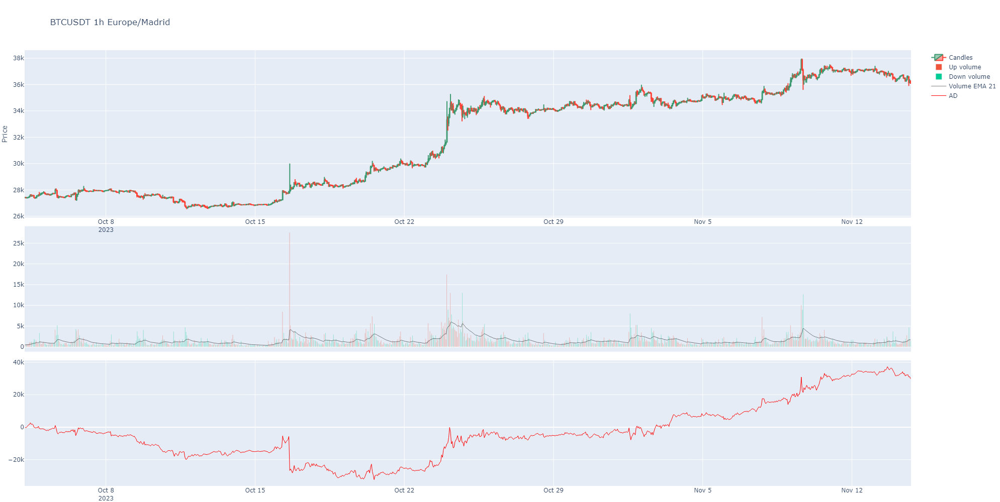

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [29]:
btcusdt.drop(inplace=True)
btcusdt.accumulation_distribution()
btcusdt.plot(candles_ta_height_ratio=0.4)

## Cleaning again

In [30]:
btcusdt.drop(inplace=True)
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp
BTCUSDT 1h Europe/Madrid,,,,,,,,,,,,,,
2023-10-04 05:00:00+02:00,2023-10-04 05:00:00+02:00,27412.14,27465.14,27404.96,27430.43,495.69234,2023-10-04 05:59:59.999000+02:00,1.359634e+07,27662,250.96368,6.883422e+06,0,1696388400000,1696391999999
2023-10-04 06:00:00+02:00,2023-10-04 06:00:00+02:00,27430.43,27430.44,27380.16,27388.69,415.55456,2023-10-04 06:59:59.999000+02:00,1.138777e+07,26166,160.02013,4.384979e+06,0,1696392000000,1696395599999
2023-10-04 07:00:00+02:00,2023-10-04 07:00:00+02:00,27388.68,27407.42,27357.10,27407.18,551.99969,2023-10-04 07:59:59.999000+02:00,1.511687e+07,27499,246.76608,6.757655e+06,0,1696395600000,1696399199999
2023-10-04 08:00:00+02:00,2023-10-04 08:00:00+02:00,27407.18,27419.99,27350.75,27419.99,592.24790,2023-10-04 08:59:59.999000+02:00,1.622025e+07,31753,307.98294,8.435302e+06,0,1696399200000,1696402799999
2023-10-04 09:00:00+02:00,2023-10-04 09:00:00+02:00,27419.99,27454.98,27405.50,27453.78,697.67116,2023-10-04 09:59:59.999000+02:00,1.913777e+07,33750,333.95262,9.160863e+06,0,1696402800000,1696406399999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-14 14:00:00+01:00,2023-11-14 14:00:00+01:00,36348.48,36671.22,36344.85,36503.26,2796.85236,2023-11-14 14:59:59.999000+01:00,1.021498e+08,88076,1430.86542,5.225486e+07,0,1699966800000,1699970399999
2023-11-14 15:00:00+01:00,2023-11-14 15:00:00+01:00,36503.26,36693.01,36462.24,36594.81,1744.40485,2023-11-14 15:59:59.999000+01:00,6.383131e+07,58469,911.47297,3.335072e+07,0,1699970400000,1699973999999
2023-11-14 16:00:00+01:00,2023-11-14 16:00:00+01:00,36594.80,36619.89,35889.00,36147.09,4676.55905,2023-11-14 16:59:59.999000+01:00,1.692032e+08,126648,2061.29968,7.457479e+07,0,1699974000000,1699977599999


C:\Users\hanca\PycharmProjects\binpan_studio\binpan\symbol_manager.py:2605: UserWarning:

Converting to PeriodArray/Index representation will drop timezone information.

2023-11-14	 19:16:27     INFO New column: VWAP_D


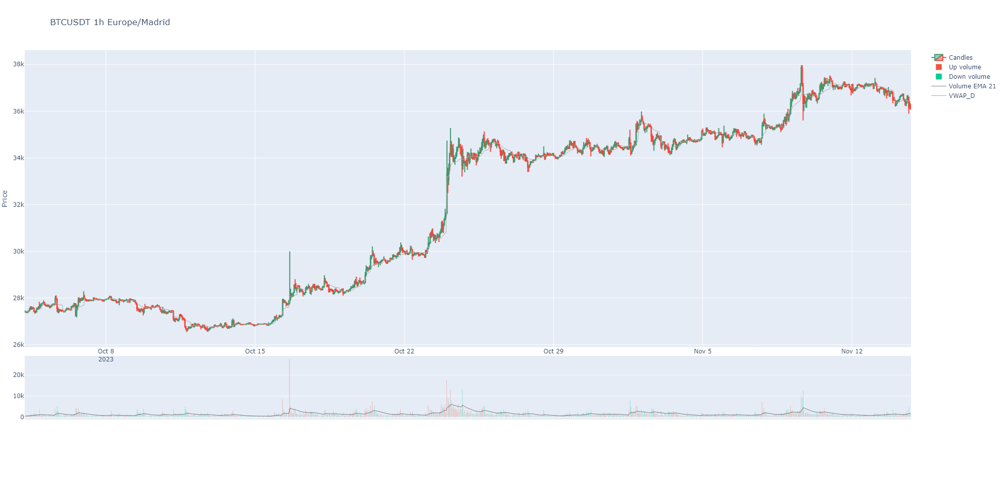

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [31]:
btcusdt.vwap()
btcusdt.plot(candles_ta_height_ratio=0.7)

# maybe, you get a pandas_ta library warning

2023-11-14	 19:16:27     INFO New column: ATRr_14


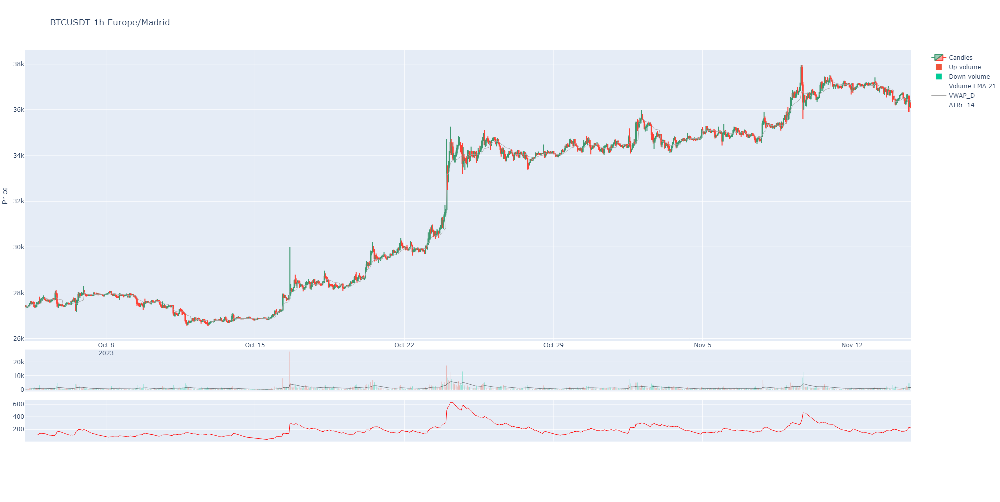

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [32]:
btcusdt.atr()
btcusdt.plot(candles_ta_height_ratio=0.7)

2023-11-14	 19:16:28     INFO New column: CCI_14_0.015


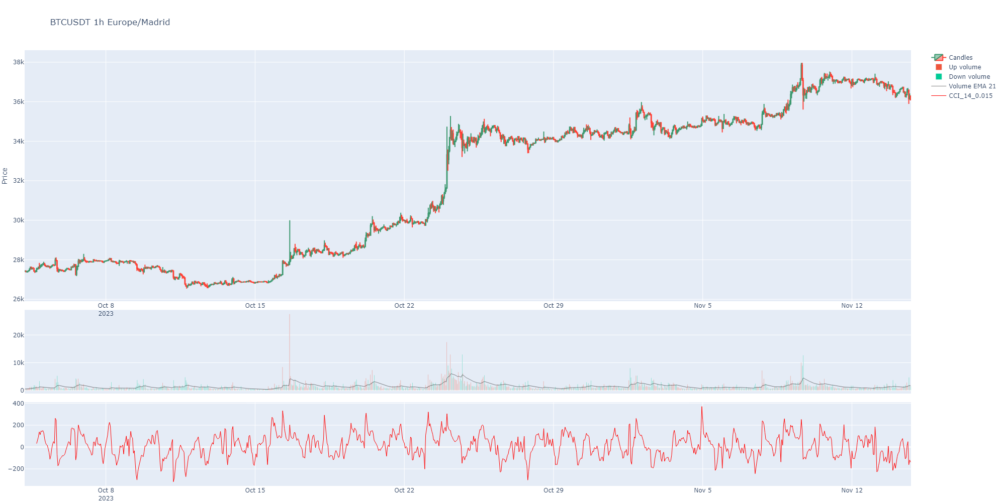

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [33]:
btcusdt.drop(inplace=True)
btcusdt.cci()
btcusdt.plot(candles_ta_height_ratio=0.6)

2023-11-14	 19:16:28     INFO New column: EOM_14_100000000


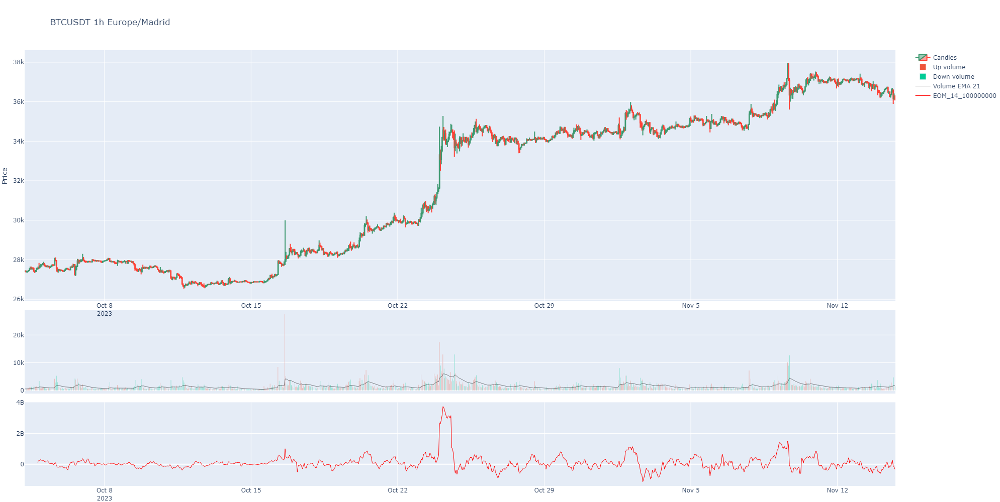

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [34]:
btcusdt.drop(inplace=True)
btcusdt.eom(length=14, divisor=100000000, drift=1)
btcusdt.plot(candles_ta_height_ratio=0.6)

2023-11-14	 19:16:29     INFO New column: ROC_1


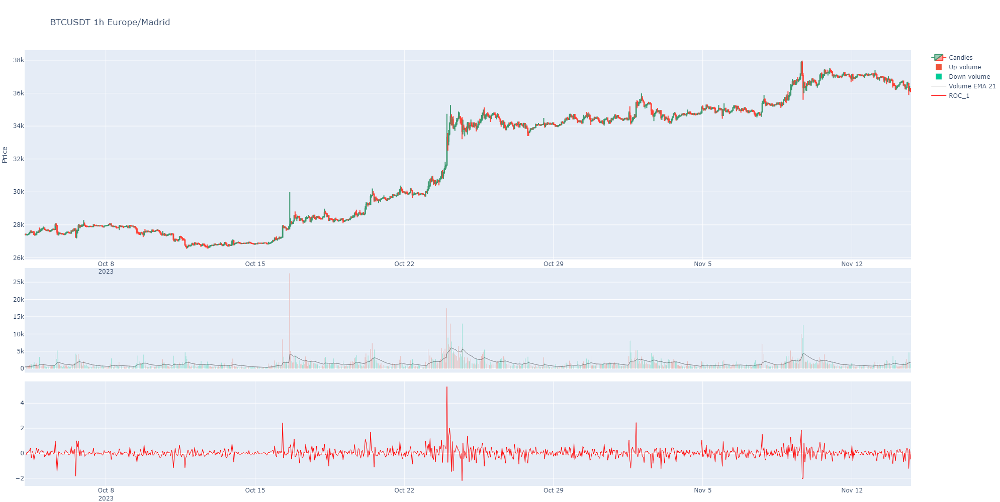

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [35]:
btcusdt.drop(inplace=True)
btcusdt.roc()
btcusdt.plot(candles_ta_height_ratio=0.5)

2023-11-14	 19:16:29     INFO New column: Ichimoku_tenkan_9
2023-11-14	 19:16:29     INFO New column: Ichimoku_kijun_26
2023-11-14	 19:16:29     INFO New column: Ichimoku_chikou_span26
2023-11-14	 19:16:29     INFO New column: Ichimoku_cloud_9_26
2023-11-14	 19:16:29     INFO New column: Ichimoku_cloud_52


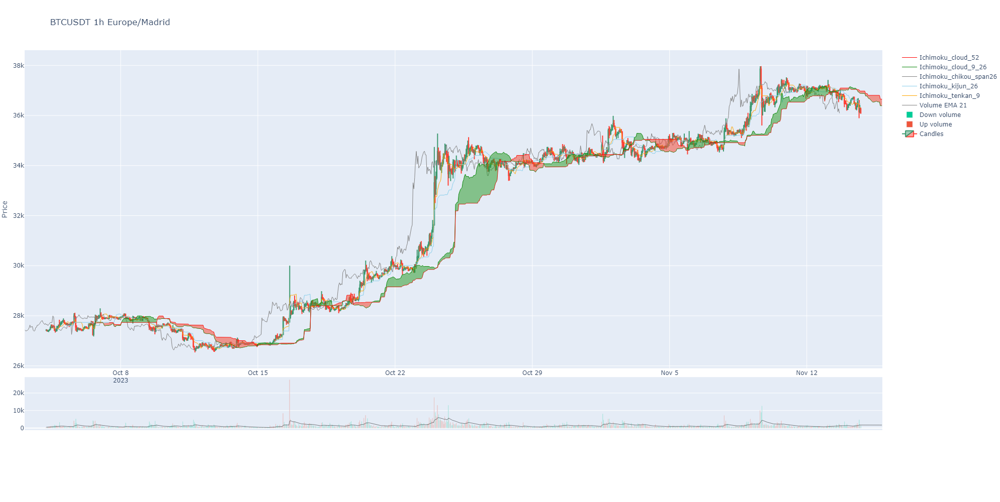

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [36]:
btcusdt.drop(inplace=True)
btcusdt.ichimoku()
btcusdt.plot()

2023-11-14	 19:16:31     INFO New column: BBL_5_2.0_
2023-11-14	 19:16:31     INFO New column: BBM_5_2.0_
2023-11-14	 19:16:31     INFO New column: BBU_5_2.0_
2023-11-14	 19:16:31     INFO New column: BBB_5_2.0_
2023-11-14	 19:16:31     INFO New column: BBP_5_2.0_


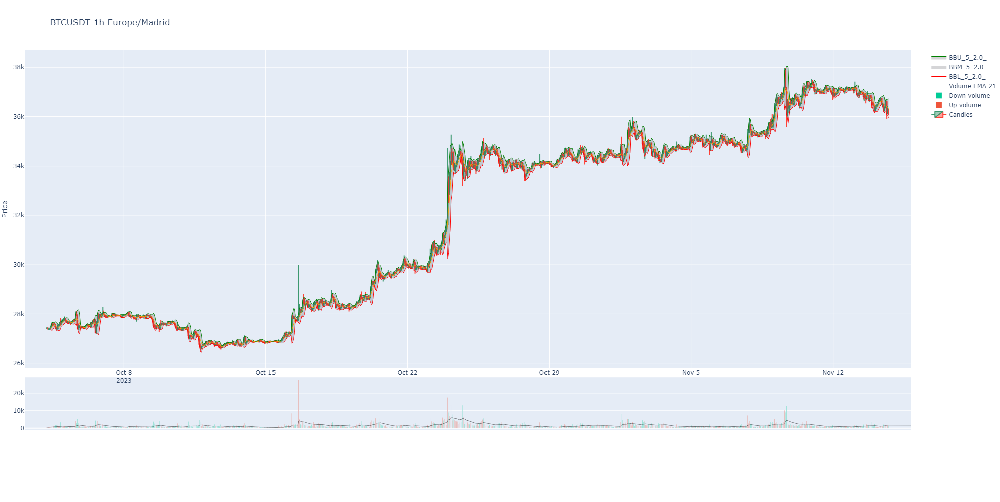

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [37]:
btcusdt.drop(inplace=True)
btcusdt.bbands()
btcusdt.plot()

In [38]:
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp,BBL_5_2.0_,BBM_5_2.0_,BBU_5_2.0_,BBB_5_2.0_,BBP_5_2.0_
BTCUSDT 1h Europe/Madrid,,,,,,,,,,,,,,,,,,,
2023-10-03 03:00:00+02:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-10-03 04:00:00+02:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-10-03 05:00:00+02:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-10-03 06:00:00+02:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-10-03 07:00:00+02:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-15 16:00:00+01:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-11-15 17:00:00+01:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-11-15 18:00:00+01:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Clean for Stochastic Oscillator

In [39]:
btcusdt = binpan.Symbol(symbol='BTCUSDT', tick_interval='1m', time_zone='Europe/Madrid')
btcusdt.df

2023-11-14	 19:16:31     INFO get_candles_by_time_stamps -> symbol=BTCUSDT tick_interval=1m start=2023-11-14 02:36:31 end=2023-11-14 19:15:58
2023-11-14	 19:16:32  WARNING API response missing 1 klines (maybe not closed yet) for BTCUSDT 2023-11-14 02:36:31 to 2023-11-14 19:15:58 expected 1000 got 999


,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp
BTCUSDT 1m Europe/Madrid,,,,,,,,,,,,,,
2023-11-14 02:37:00+01:00,2023-11-14 02:37:00+01:00,36396.00,36396.01,36381.10,36381.11,11.86092,2023-11-14 02:37:59.999000+01:00,4.316561e+05,510,4.01095,1.459765e+05,0,1699925820000,1699925879999
2023-11-14 02:38:00+01:00,2023-11-14 02:38:00+01:00,36381.11,36381.11,36372.73,36380.57,10.07857,2023-11-14 02:38:59.999000+01:00,3.665968e+05,390,6.89946,2.509555e+05,0,1699925880000,1699925939999
2023-11-14 02:39:00+01:00,2023-11-14 02:39:00+01:00,36380.56,36394.83,36380.56,36394.83,4.49012,2023-11-14 02:39:59.999000+01:00,1.633998e+05,318,2.44876,8.911055e+04,0,1699925940000,1699925999999
2023-11-14 02:40:00+01:00,2023-11-14 02:40:00+01:00,36394.83,36394.83,36380.56,36380.57,4.07135,2023-11-14 02:40:59.999000+01:00,1.481558e+05,386,0.63222,2.300683e+04,0,1699926000000,1699926059999
2023-11-14 02:41:00+01:00,2023-11-14 02:41:00+01:00,36380.57,36380.63,36380.43,36380.44,16.94470,2023-11-14 02:41:59.999000+01:00,6.164579e+05,324,2.51201,9.138835e+04,0,1699926060000,1699926119999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-14 19:11:00+01:00,2023-11-14 19:11:00+01:00,35969.92,36005.16,35966.00,35977.41,47.56521,2023-11-14 19:11:59.999000+01:00,1.711621e+06,1480,22.55368,8.115451e+05,0,1699985460000,1699985519999
2023-11-14 19:12:00+01:00,2023-11-14 19:12:00+01:00,35977.40,35980.00,35912.38,35919.56,108.06705,2023-11-14 19:12:59.999000+01:00,3.883466e+06,3134,51.78130,1.860684e+06,0,1699985520000,1699985579999
2023-11-14 19:13:00+01:00,2023-11-14 19:13:00+01:00,35919.57,35948.00,35828.00,35911.99,216.77049,2023-11-14 19:13:59.999000+01:00,7.777111e+06,6197,86.14836,3.090289e+06,0,1699985580000,1699985639999


In [40]:
btcusdt.stoch()

2023-11-14	 19:16:32     INFO New column: STOCHk_14_3_3
2023-11-14	 19:16:32     INFO New column: STOCHd_14_3_3


,STOCHk_14_3_3,STOCHd_14_3_3
BTCUSDT 1m Europe/Madrid,,
2023-11-14 02:50:00+01:00,NaN,NaN
2023-11-14 02:51:00+01:00,NaN,NaN
2023-11-14 02:52:00+01:00,54.434043,NaN
2023-11-14 02:53:00+01:00,64.397163,NaN
2023-11-14 02:54:00+01:00,64.573050,61.134752
...,...,...
2023-11-14 19:11:00+01:00,16.158068,18.460263
2023-11-14 19:12:00+01:00,13.809414,14.792076
2023-11-14 19:13:00+01:00,17.533277,15.833586


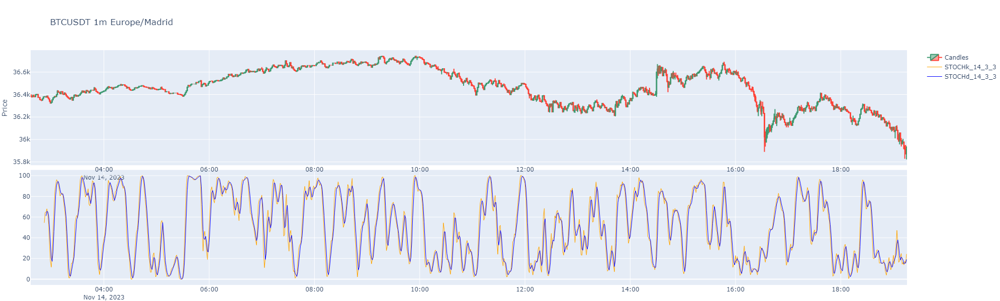

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [41]:
btcusdt.plot(volume=False, height=600, candles_ta_height_ratio=0.5)

# Simple indicator addition by insertion

In [42]:
btcusdt = binpan.Symbol(symbol='BTCUSDT', tick_interval='1m', time_zone='Europe/Madrid')
btcusdt.df

2023-11-14	 19:16:33     INFO get_candles_by_time_stamps -> symbol=BTCUSDT tick_interval=1m start=2023-11-14 02:36:33 end=2023-11-14 19:15:58
2023-11-14	 19:16:33  WARNING API response missing 1 klines (maybe not closed yet) for BTCUSDT 2023-11-14 02:36:33 to 2023-11-14 19:15:58 expected 1000 got 999


,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp
BTCUSDT 1m Europe/Madrid,,,,,,,,,,,,,,
2023-11-14 02:37:00+01:00,2023-11-14 02:37:00+01:00,36396.00,36396.01,36381.10,36381.11,11.86092,2023-11-14 02:37:59.999000+01:00,4.316561e+05,510,4.01095,1.459765e+05,0,1699925820000,1699925879999
2023-11-14 02:38:00+01:00,2023-11-14 02:38:00+01:00,36381.11,36381.11,36372.73,36380.57,10.07857,2023-11-14 02:38:59.999000+01:00,3.665968e+05,390,6.89946,2.509555e+05,0,1699925880000,1699925939999
2023-11-14 02:39:00+01:00,2023-11-14 02:39:00+01:00,36380.56,36394.83,36380.56,36394.83,4.49012,2023-11-14 02:39:59.999000+01:00,1.633998e+05,318,2.44876,8.911055e+04,0,1699925940000,1699925999999
2023-11-14 02:40:00+01:00,2023-11-14 02:40:00+01:00,36394.83,36394.83,36380.56,36380.57,4.07135,2023-11-14 02:40:59.999000+01:00,1.481558e+05,386,0.63222,2.300683e+04,0,1699926000000,1699926059999
2023-11-14 02:41:00+01:00,2023-11-14 02:41:00+01:00,36380.57,36380.63,36380.43,36380.44,16.94470,2023-11-14 02:41:59.999000+01:00,6.164579e+05,324,2.51201,9.138835e+04,0,1699926060000,1699926119999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-14 19:11:00+01:00,2023-11-14 19:11:00+01:00,35969.92,36005.16,35966.00,35977.41,47.56521,2023-11-14 19:11:59.999000+01:00,1.711621e+06,1480,22.55368,8.115451e+05,0,1699985460000,1699985519999
2023-11-14 19:12:00+01:00,2023-11-14 19:12:00+01:00,35977.40,35980.00,35912.38,35919.56,108.06705,2023-11-14 19:12:59.999000+01:00,3.883466e+06,3134,51.78130,1.860684e+06,0,1699985520000,1699985579999
2023-11-14 19:13:00+01:00,2023-11-14 19:13:00+01:00,35919.57,35948.00,35828.00,35911.99,216.77049,2023-11-14 19:13:59.999000+01:00,7.777111e+06,6197,86.14836,3.090289e+06,0,1699985580000,1699985639999


In [43]:
volume_diff = btcusdt.df['Volume'].diff()
volume_diff

BTCUSDT 1m Europe/Madrid
2023-11-14 02:37:00+01:00          NaN
2023-11-14 02:38:00+01:00     -1.78235
2023-11-14 02:39:00+01:00     -5.58845
2023-11-14 02:40:00+01:00     -0.41877
2023-11-14 02:41:00+01:00     12.87335
                               ...    
2023-11-14 19:11:00+01:00      3.34132
2023-11-14 19:12:00+01:00     60.50184
2023-11-14 19:13:00+01:00    108.70344
2023-11-14 19:14:00+01:00   -145.31095
2023-11-14 19:15:00+01:00     36.82081
Name: Volume, Length: 999, dtype: float64

In [44]:
zero = volume_diff*0
zero

BTCUSDT 1m Europe/Madrid
2023-11-14 02:37:00+01:00    NaN
2023-11-14 02:38:00+01:00   -0.0
2023-11-14 02:39:00+01:00   -0.0
2023-11-14 02:40:00+01:00   -0.0
2023-11-14 02:41:00+01:00    0.0
                            ... 
2023-11-14 19:11:00+01:00    0.0
2023-11-14 19:12:00+01:00    0.0
2023-11-14 19:13:00+01:00    0.0
2023-11-14 19:14:00+01:00   -0.0
2023-11-14 19:15:00+01:00    0.0
Name: Volume, Length: 999, dtype: float64

In [45]:
btcusdt.insert_indicator(source_data=[volume_diff, zero], plotting_rows=[2,2], names=['Volume_diff', 'Zero'], colors=['blue', 'darkgrey'])
btcusdt.row_control

2023-11-14	 19:16:34     INFO New column: Volume_diff
2023-11-14	 19:16:34     INFO New column: Zero


{'Volume_diff': 2, 'Zero': 3}

In [46]:
btcusdt.set_plot_row('Zero', 2)
btcusdt.row_control

{'Volume_diff': 2, 'Zero': 2}

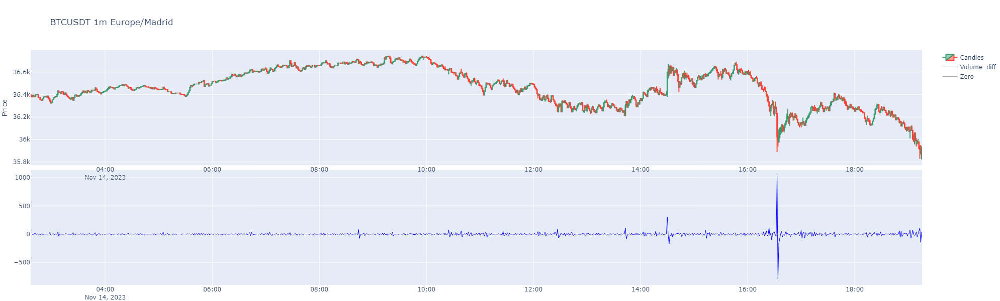

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [47]:
btcusdt.plot(volume=False, height=600, candles_ta_height_ratio=0.5)

## Check for 3 positive volume differences in a row.
This was just an experiment.

In [48]:
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp,Volume_diff,Zero
BTCUSDT 1m Europe/Madrid,,,,,,,,,,,,,,,,
2023-11-14 02:37:00+01:00,2023-11-14 02:37:00+01:00,36396.00,36396.01,36381.10,36381.11,11.86092,2023-11-14 02:37:59.999000+01:00,4.316561e+05,510,4.01095,1.459765e+05,0,1699925820000,1699925879999,NaN,NaN
2023-11-14 02:38:00+01:00,2023-11-14 02:38:00+01:00,36381.11,36381.11,36372.73,36380.57,10.07857,2023-11-14 02:38:59.999000+01:00,3.665968e+05,390,6.89946,2.509555e+05,0,1699925880000,1699925939999,-1.78235,-0.0
2023-11-14 02:39:00+01:00,2023-11-14 02:39:00+01:00,36380.56,36394.83,36380.56,36394.83,4.49012,2023-11-14 02:39:59.999000+01:00,1.633998e+05,318,2.44876,8.911055e+04,0,1699925940000,1699925999999,-5.58845,-0.0
2023-11-14 02:40:00+01:00,2023-11-14 02:40:00+01:00,36394.83,36394.83,36380.56,36380.57,4.07135,2023-11-14 02:40:59.999000+01:00,1.481558e+05,386,0.63222,2.300683e+04,0,1699926000000,1699926059999,-0.41877,-0.0
2023-11-14 02:41:00+01:00,2023-11-14 02:41:00+01:00,36380.57,36380.63,36380.43,36380.44,16.94470,2023-11-14 02:41:59.999000+01:00,6.164579e+05,324,2.51201,9.138835e+04,0,1699926060000,1699926119999,12.87335,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-14 19:11:00+01:00,2023-11-14 19:11:00+01:00,35969.92,36005.16,35966.00,35977.41,47.56521,2023-11-14 19:11:59.999000+01:00,1.711621e+06,1480,22.55368,8.115451e+05,0,1699985460000,1699985519999,3.34132,0.0
2023-11-14 19:12:00+01:00,2023-11-14 19:12:00+01:00,35977.40,35980.00,35912.38,35919.56,108.06705,2023-11-14 19:12:59.999000+01:00,3.883466e+06,3134,51.78130,1.860684e+06,0,1699985520000,1699985579999,60.50184,0.0
2023-11-14 19:13:00+01:00,2023-11-14 19:13:00+01:00,35919.57,35948.00,35828.00,35911.99,216.77049,2023-11-14 19:13:59.999000+01:00,7.777111e+06,6197,86.14836,3.090289e+06,0,1699985580000,1699985639999,108.70344,0.0


In [49]:
positive_col_row = btcusdt.df['Volume_diff'].rolling(window=3).agg(lambda x: (x > 0).sum())
positive_col_row[positive_col_row==3]

BTCUSDT 1m Europe/Madrid
2023-11-14 03:17:00+01:00    3.0
2023-11-14 03:49:00+01:00    3.0
2023-11-14 05:00:00+01:00    3.0
2023-11-14 05:01:00+01:00    3.0
2023-11-14 05:02:00+01:00    3.0
                            ... 
2023-11-14 18:13:00+01:00    3.0
2023-11-14 18:57:00+01:00    3.0
2023-11-14 18:58:00+01:00    3.0
2023-11-14 19:02:00+01:00    3.0
2023-11-14 19:13:00+01:00    3.0
Name: Volume_diff, Length: 45, dtype: float64

# Fractal

In [50]:
sym = binpan.Symbol(symbol='ltcusdt',
                        tick_interval='1h',
                        limit=200,
                        time_zone='Europe/Madrid')

2023-11-14	 19:16:35     INFO get_candles_by_time_stamps -> symbol=LTCUSDT tick_interval=1h start=2023-11-06 11:16:35 end=2023-11-14 18:59:58
2023-11-14	 19:16:35  WARNING API response missing 1 klines (maybe not closed yet) for LTCUSDT 2023-11-06 11:16:35 to 2023-11-14 18:59:58 expected 200 got 199


In [51]:
sym.fractal(period=5)

2023-11-14	 19:16:36     INFO New column: Fractal_W_5
2023-11-14	 19:16:36     INFO New column: Fractal_W_5_values


,Fractal_W_5,Fractal_W_5_values
LTCUSDT 1h Europe/Madrid,,
2023-11-06 12:00:00+01:00,0.0,NaN
2023-11-06 13:00:00+01:00,0.0,NaN
2023-11-06 14:00:00+01:00,0.0,NaN
2023-11-06 15:00:00+01:00,0.0,NaN
2023-11-06 16:00:00+01:00,0.0,NaN
...,...,...
2023-11-14 14:00:00+01:00,0.0,NaN
2023-11-14 15:00:00+01:00,0.0,NaN
2023-11-14 16:00:00+01:00,0.0,NaN


In [52]:
sym.color_control

{'Fractal_W_5': 'black', 'Fractal_W_5_values': 'black'}

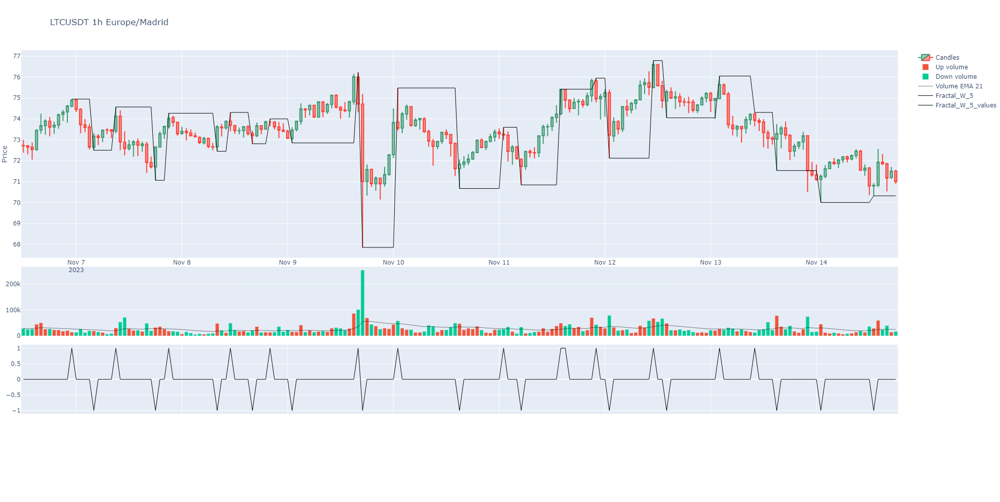

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [53]:
sym.plot(candles_ta_height_ratio=0.5)

# Alternating Fractal
This custom indicator shows the minimum period in finding a pure alternating fractal. It is some kind of volatility in price indicator, the most period needed, the most volatile price.

In [54]:
sym = binpan.Symbol(symbol='btcusdt',
                        tick_interval='1m',
                        limit=2000,
                        time_zone='Europe/Madrid')

2023-11-14	 19:16:36     INFO get_candles_by_time_stamps -> symbol=BTCUSDT tick_interval=1m start=2023-11-13 09:56:36 end=2023-11-14 19:15:58
2023-11-14	 19:16:37  WARNING API response missing 1 klines (maybe not closed yet) for BTCUSDT 2023-11-14 02:36:36 to 2023-11-14 19:15:58 expected 1000 got 999


In [55]:
fractal, maximums_mean, minimums_mean = sym.alternating_fractal(max_period=1000, overlap_plot=True, with_trend=True)
maximums_mean, minimums_mean

Searching for pure alternating fractal...


  0%|          | 0/998 [00:00<?, ?it/s]

2023-11-14	 19:16:46     INFO Decreasing maxima and decreasing minima. downtrend
2023-11-14	 19:16:46     INFO Max mean: -112.81333333333168 Min mean: -109.41000000000106
2023-11-14	 19:16:46     INFO New column: Fractal_W_162
2023-11-14	 19:16:46     INFO New column: Fractal_W_162_values


Pure alternating fractal found at period=162
Maximum_max_diff=-50.98999999999796
Minimum_max_diff=-156.4499999999971
Maximum_min_diff=66.95999999999913
Minimum_min_diff=-410.83000000000175
Decreasing maxima and decreasing minima. downtrend


(-112.81333333333168, -109.41000000000106)

In [56]:
fractal.dropna()

,Fractal_W_162,Fractal_W_162_values
BTCUSDT 1m Europe/Madrid,,
2023-11-13 15:46:00+01:00,-1.0,36534.04
2023-11-13 17:25:00+01:00,1.0,37031.45
2023-11-13 19:08:00+01:00,-1.0,36601.00
2023-11-13 21:05:00+01:00,1.0,36875.00
2023-11-14 01:59:00+01:00,-1.0,36190.17
2023-11-14 09:56:00+01:00,1.0,36744.00
2023-11-14 13:43:00+01:00,-1.0,36205.81
2023-11-14 15:47:00+01:00,1.0,36693.01


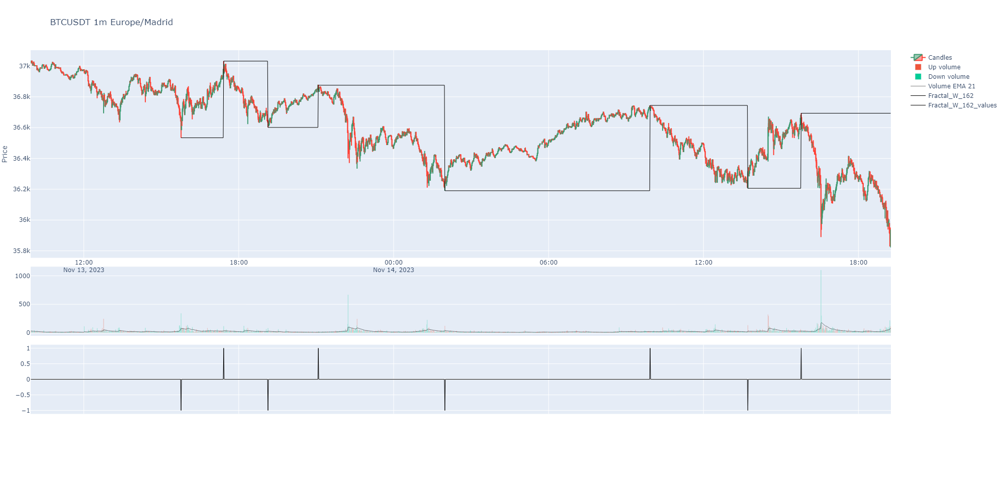

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [57]:
sym.plot(candles_ta_height_ratio=0.5)

# Market Profile Indicator

In [58]:
mp = sym.get_market_profile(bins=100)
mp

2023-11-14	 19:16:47     INFO Using klines data. For deeper info add trades data, example: my_symbol.get_agg_trades()
C:\Users\hanca\PycharmProjects\binpan_studio\handlers\indicators.py:1080: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,Taker buy base volume,Maker buy base volume
Price_Bin_BTCUSDT 1m Europe/Madrid_Klines,,
"(35890.363, 35902.91]",157.64269,238.86769
"(35902.91, 35914.316]",0.00000,0.00000
"(35914.316, 35925.723]",0.00000,0.00000
"(35925.723, 35937.129]",0.00000,0.00000
"(35937.129, 35948.535]",51.78130,56.28575
...,...,...
"(36975.111, 36986.518]",192.43213,220.46571
"(36986.518, 36997.924]",116.29025,116.81077
"(36997.924, 37009.331]",125.96194,182.06712


2023-11-14	 19:16:47     INFO Using klines data. For deeper info add trades data, example: my_symbol.get_agg_trades()
C:\Users\hanca\PycharmProjects\binpan_studio\handlers\plotting.py:1384: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



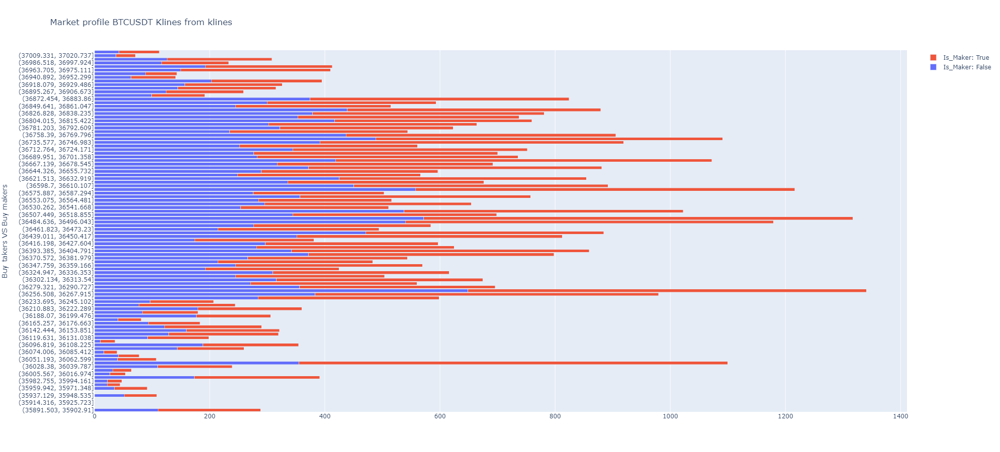

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [59]:
sym.plot_market_profile()

# Taker Maker ratio by price leves

In [60]:
sym.get_taker_maker_ratio_profile()

Price_Bin_BTCUSDT 1m Europe/Madrid_Klines
(35890.363, 35902.91]     0.397575
(35902.91, 35914.316]          NaN
(35914.316, 35925.723]         NaN
(35925.723, 35937.129]         NaN
(35937.129, 35948.535]    0.479159
                            ...   
(36975.111, 36986.518]    0.466053
(36986.518, 36997.924]    0.498883
(36997.924, 37009.331]    0.408929
(37009.331, 37020.737]    0.527995
(37020.737, 37032.143]    0.380036
Length: 100, dtype: float64

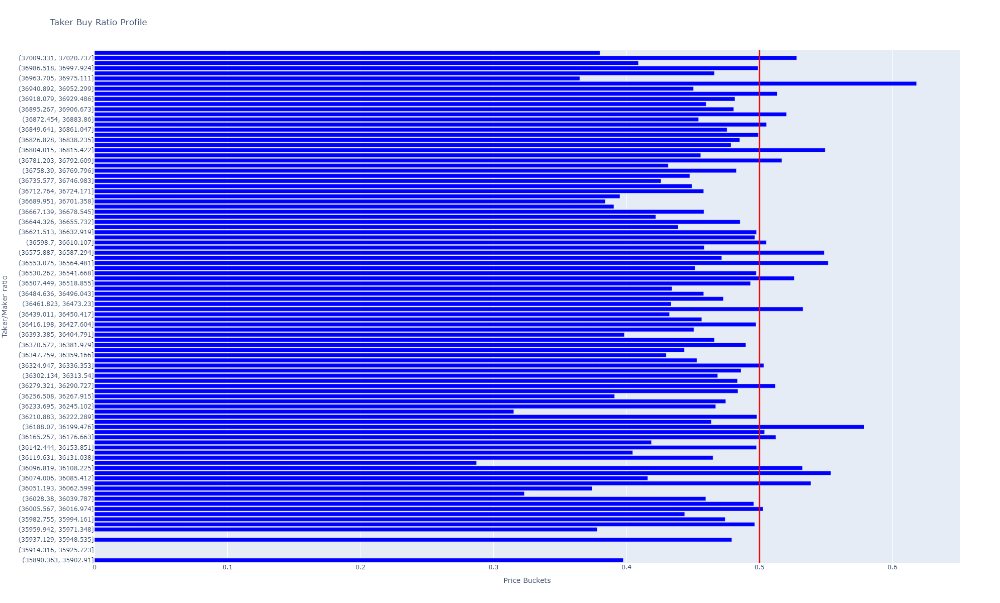

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [61]:
sym.plot_taker_maker_ratio_profile()